## 복습

가설검정

In [1]:
import pandas as pd

df1 = pd.read_csv('01_Data.csv')
df1.head(2)


,Index,Member_ID,Sales_Type,Contract_Type,Channel,Datetime,Term,Payment_Type,Product_Type,Amount_Month,Customer_Type,Age,Address1,Address2,State,Overdue_count,Overdue_Type,Gender,Credit_Rank,Bank
0,1,66758234,렌탈,일반계약,영업방판,2022-05-05,60,CMS,DES-1,96900,개인,42.0,경기도,경기도,계약확정,0,없음,여자,9.0,새마을금고
1,2,66755948,렌탈,교체계약,영업방판,2023-02-19,60,카드이체,DES-1,102900,개인,39.0,경기도,경기도,계약확정,0,없음,남자,2.0,현대카드


In [2]:
# 연체 여부에 따라 월렌탈비용에 차이가 있는가?

df1['Overdue_Type'].unique()

array(['없음', '있음'], dtype=object)

In [3]:
cond1 =(df1['Overdue_Type']=='있음')

df_over = df1.loc[cond1]
df_norm = df1.loc[~cond1]

# ~ : Not
# ~cond1 : Overdue_Type : 없음

In [4]:
import scipy.stats as stats
# 가설검정 라이브러리

In [6]:
# 정규성 검정

stats.normaltest(df_over['Amount_Month'])

# e-199 : 0.0000~~~0 199번째 자리에 가서야 3.93~~가 시작됨
# pvalue < 0.05 보다 작으므로 대립가설 , 정규성을 따르지 않는다.

NormaltestResult(statistic=913.6886264858254, pvalue=3.935824000627175e-199)

In [7]:
stats.normaltest(df_norm['Amount_Month'])

NormaltestResult(statistic=5175.1150773834515, pvalue=0.0)

In [9]:
# 둘 중 하나라도 정규분포를 따르지 않으면 순위합 검정
# ranksum 사용

stats.ranksums(df_over['Amount_Month'],df_norm['Amount_Month'])

RanksumsResult(statistic=13.151893506752453, pvalue=1.659655618882019e-39)

In [10]:
# 귀무가설 : 두 집단에 유의미한 차이가 없을 것이다.
# 대립가설 : 두 집단의 유의미한 차이가 있을 것이다

# pvalue가 0에 가깝기에 대립가설 채택
# pvalue < 0.05 보다 작으므로 대립가설 채택 , 정규성을 따르지 않는다.

## 다변수 검정

In [11]:
# 채널 별 월렌탈비용의 차이가 있는가?

df1['Channel'].value_counts()

Channel
영업방판       23767
홈쇼핑/방송     12977
대형마트A       4725
전문매장H       3227
재계약         2193
대형마트E       1497
전문매장Z       1206
전단홍보         560
홈쇼핑/인터넷      375
대형마트H        225
직영유통사        188
자체홈페이지       120
대형마트C        119
대형마트N         83
직영계열사A        20
직영계열사B        19
Name: count, dtype: int64

In [13]:
top3_list = df1['Channel'].value_counts().head(3).index
top3_list

Index(['영업방판', '홈쇼핑/방송', '대형마트A'], dtype='object', name='Channel')

In [14]:
cond1 = (df1['Channel']==top3_list[0])
cond2 = (df1['Channel']==top3_list[1])
cond3 = (df1['Channel']==top3_list[2])

# 각 영업방판 / 홈쇼핑방송 / 대형마트 A

In [15]:
print( stats.normaltest( df1.loc[cond1]['Amount_Month']))
print( stats.normaltest( df1.loc[cond2]['Amount_Month']))
print( stats.normaltest( df1.loc[cond3]['Amount_Month']))

# pvalue < 0.05 보다 전부 작다 대립가설 채택 , 정규분포를 따르지 않는다. 유의미한 차이가 있다.
# 세 집단 모두 정규분포를 따르지 않음

NormaltestResult(statistic=13426.784616830582, pvalue=0.0)
NormaltestResult(statistic=721.5700572037006, pvalue=2.0561411505237054e-157)
NormaltestResult(statistic=1450.8543571263506, pvalue=0.0)


In [17]:
# 세 집단의 차이를 확인
# 다변수는 kruskal 사용하면된다.
stats.kruskal( df1.loc[cond1]['Amount_Month'],
             df1.loc[cond2]['Amount_Month'],
             df1.loc[cond3]['Amount_Month'])

# 귀무가설 : 세 집단은 통계적으로 유의미한 차이가 없다
# 대립가설 : 세집단은 통계적으로 유의미한 차이가 있다.

# 대립가설 채택  <-- pvalue <0.05 

KruskalResult(statistic=8746.944998588246, pvalue=0.0)

In [ ]:
# kruskal test는 어느 집단이 서로 다른지 알려주지는 못한다.
# 후속비교를 한번 더 해야한다.

## 미션풀이
- 
Day6_Data.zip 내, 3개의 데이터 파일을 불러와 아래의 분석을 실시하시오

- 3개 데이터를 불러와 아래와 같이 변환 하시오.
- 
기간은 파일 상단에 적힌 기간월을 성
- 
Column 명 '합계'는 앞에 공백이 존재 ' 합계'.

In [18]:
import os 

In [19]:
os.listdir()

['.ipynb_checkpoints',
 '01_Data.csv',
 '02_Data.xlsx',
 '03_Data.csv',
 '03_Delivery.csv',
 '05_Detection.csv',
 '05_Process_A.csv',
 '06_Data.csv',
 '06_Data_001.csv',
 '06_store_member.csv',
 '06_store_product.csv',
 '09_Data.csv',
 'Day01.ipynb',
 'Day01_Mission_데이터 타입1.ipynb',
 'Day01_Mission_반복문.ipynb',
 'Day02.ipynb',
 'Day02_Mission1.ipynb',
 'Day02_Mission2.ipynb',
 'Day03.ipynb',
 'Day03_Mission1.ipynb',
 'Day03_Mission2.ipynb',
 'Day03_Mission3.ipynb',
 'Day04.ipynb',
 'Day04_Mission.ipynb',
 'Day05.ipynb',
 'Day05_Mission.ipynb',
 'Day06.ipynb',
 'Day06_Mission.ipynb',
 'Day07.ipynb',
 'df1_clean.csv',
 'df1_describe.xlsx',
 'melt.csv',
 'Merge_Data.csv',
 'modul1.py',
 'package1',
 'plotly쿠팡.html',
 'result03.xlsx',
 'result2.xlsx',
 'result_categoty.xlsx',
 'result_young1.xlsx',
 'result_세탁세제.xlsx',
 'ST_월별_쿠팡출고량.png',
 '__pycache__',
 '기간발주데이터_1905001.csv',
 '기간발주데이터_1906001.csv',
 '기간발주데이터_1907001.csv',
 '기간발주데이터_1908001.csv',
 '기간별상품매출현황_202306.xlsx',
 '기간별상품매출현황_20230

In [21]:
list1 =[]
for i in os.listdir():
    if '기간별상품매출' in i:
        list1.append(i)

list1            

['기간별상품매출현황_202306.xlsx', '기간별상품매출현황_202307.xlsx', '기간별상품매출현황_202308.xlsx']

In [32]:
for i in list1:
    print(i[-7:-5])

# 이까지 만들어 놓고 테이블을 정제하여 다시 for문 안에 작성할 거임

06
07
08


In [23]:
p1 = pd.read_excel('기간별상품매출현황_202306.xlsx')
p1.head(5)
# skiprow 옵션을 사용하여 위의 두 줄을 날려버리고
# 그 다음줄을 컬럼으로 사용

,조회기간-시작 = 20230601,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 636,Unnamed: 637,Unnamed: 638,Unnamed: 639,Unnamed: 640,Unnamed: 641,Unnamed: 642,Unnamed: 643,Unnamed: 644,Unnamed: 645
0,조회기간-종료 = 20230630,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,순번,상품코드,상품명,합계,(1154)의정부점,(1155)별내점,(1156)풍산점,(1157)김포한강점,(1158)세종점,(1159)킨텍스점,...,(L21)위시티점,(L23)걸포동점,(L27)통일동산점,(L35)성대점,(L36)병점점,(L38)율전점,(L39)본오점,(L40)검암점,(L44)신길점,(L46)용호점
2,NaN,NaN,NaN,수량,수량,수량,수량,수량,수량,수량,...,수량,수량,수량,수량,수량,수량,수량,수량,수량,수량
3,NaN,NaN,합 계,"2,029,096","6,829","8,374","12,626","11,767","10,912","7,062",...,"2,392","1,291","4,506","2,364","2,739","1,782","3,129","1,712","3,189","2,347"
4,1,0000001801828,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,174,239,432,199,220,263,...,0,25,76,72,54,72,15,38,27,89


In [24]:
p2 = pd.read_excel('기간별상품매출현황_202306.xlsx',skiprows=2)
p2.head()

,순번,상품코드,상품명,합계,(1154)의정부점,(1155)별내점,(1156)풍산점,(1157)김포한강점,(1158)세종점,(1159)킨텍스점,...,(L21)위시티점,(L23)걸포동점,(L27)통일동산점,(L35)성대점,(L36)병점점,(L38)율전점,(L39)본오점,(L40)검암점,(L44)신길점,(L46)용호점
0,NaN,NaN,NaN,수량,수량,수량,수량,수량,수량,수량,...,수량,수량,수량,수량,수량,수량,수량,수량,수량,수량
1,NaN,NaN,합 계,"2,029,096","6,829","8,374","12,626","11,767","10,912","7,062",...,"2,392","1,291","4,506","2,364","2,739","1,782","3,129","1,712","3,189","2,347"
2,1.0,1801828.0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,174,239,432,199,220,263,...,0,25,76,72,54,72,15,38,27,89
3,2.0,1801859.0,블루방역황사마스크 65매 KF94,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3.0,40786179.0,클린위즈 매직클리너 얼룩제거 세트,2158,4,9,10,27,0,11,...,0,0,0,0,0,0,0,0,0,0


In [26]:
p3 = p2.iloc[2:]
p3.head()

# index가 2번부터 시작하지만, 후에 concat해줄 때 리셋하면된다. 

,순번,상품코드,상품명,합계,(1154)의정부점,(1155)별내점,(1156)풍산점,(1157)김포한강점,(1158)세종점,(1159)킨텍스점,...,(L21)위시티점,(L23)걸포동점,(L27)통일동산점,(L35)성대점,(L36)병점점,(L38)율전점,(L39)본오점,(L40)검암점,(L44)신길점,(L46)용호점
2,1.0,1801828.0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,174,239,432,199,220,263,...,0,25,76,72,54,72,15,38,27,89
3,2.0,1801859.0,블루방역황사마스크 65매 KF94,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,3.0,40786179.0,클린위즈 매직클리너 얼룩제거 세트,2158,4,9,10,27,0,11,...,0,0,0,0,0,0,0,0,0,0
5,4.0,41001356.0,트루마리 순수휴지 30미터 90롤,3649,14,0,17,35,20,2,...,0,0,0,0,0,0,0,0,0,0
6,5.0,88005324.0,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [28]:
p3.columns[0:4]

Index(['순번', '상품코드', '상품명', ' 합계'], dtype='object')

In [30]:
p4=p3.melt(id_vars=['순번', '상품코드', '상품명', ' 합계'])

# p3.melt(id_vars=p3.columns[0:4]) 위와 동일
p4.rename(columns={'variable':'지점','value':'판매량'},
         inplace=True)
p4.head()

,순번,상품코드,상품명,합계,지점,판매량
0,1.0,1801828.0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,(1154)의정부점,174
1,2.0,1801859.0,블루방역황사마스크 65매 KF94,1,(1154)의정부점,0
2,3.0,40786179.0,클린위즈 매직클리너 얼룩제거 세트,2158,(1154)의정부점,4
3,4.0,41001356.0,트루마리 순수휴지 30미터 90롤,3649,(1154)의정부점,14
4,5.0,88005324.0,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),1,(1154)의정부점,0


In [33]:
# 기간 컬럼 만들기
i = '기간별상품매출현황_202306.xlsx'
p4['기간'] = i[-7:-5] + '월'
p4.head()

,순번,상품코드,상품명,합계,지점,판매량,기간
0,1.0,1801828.0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,(1154)의정부점,174,06월
1,2.0,1801859.0,블루방역황사마스크 65매 KF94,1,(1154)의정부점,0,06월
2,3.0,40786179.0,클린위즈 매직클리너 얼룩제거 세트,2158,(1154)의정부점,4,06월
3,4.0,41001356.0,트루마리 순수휴지 30미터 90롤,3649,(1154)의정부점,14,06월
4,5.0,88005324.0,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),1,(1154)의정부점,0,06월


In [34]:
list1 =[] 
concat1 = pd.DataFrame()


for i in os.listdir():
    if '기간별상품매출' in i:
        list1.append(i)

for i in list1:
    p2 = pd.read_excel(i,skiprows=2)
    p3 = p2.iloc[2:]
    p4=p3.melt(id_vars=['순번', '상품코드', '상품명', ' 합계'])
    
    p4.rename(columns={'variable':'지점','value':'판매량'},
             inplace=True)
    p4['기간'] = i[-7:-5] + '월'
    concat1 = pd.concat([concat1,p4],ignore_index=True)

concat1

,순번,상품코드,상품명,합계,지점,판매량,기간
0,1.0,1.801828e+06,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,(1154)의정부점,174,06월
1,2.0,1.801859e+06,블루방역황사마스크 65매 KF94,1,(1154)의정부점,0,06월
2,3.0,4.078618e+07,클린위즈 매직클리너 얼룩제거 세트,2158,(1154)의정부점,4,06월
3,4.0,4.100136e+07,트루마리 순수휴지 30미터 90롤,3649,(1154)의정부점,14,06월
4,5.0,8.800532e+07,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),1,(1154)의정부점,0,06월
...,...,...,...,...,...,...,...
236993,126.0,8.801858e+12,[쨍하고해뜰집]제습제풀세트(다용도제습제30통+지시겔1봉),653,(L46)용호점,0,08월
236994,127.0,8.801858e+12,[리얼뽀송이]제습제세트,3233,(L46)용호점,0,08월
236995,128.0,8.801858e+12,[미라클워터]다목적세정제17종괴물용량풀세트,8433,(L46)용호점,0,08월
236996,129.0,8.801858e+12,[쨍하고해뜰집]지시겔1봉(20개),135839,(L46)용호점,145,08월


In [36]:
(concat1['판매량']=='수량').sum()

0

## 2. '지점' 중 '판매량'의 합이 가장 높은 2개 지점을 확인하시오.

In [37]:
concat1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 236998 entries, 0 to 236997
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   순번      236998 non-null  float64
 1   상품코드    236998 non-null  float64
 2   상품명     236998 non-null  object 
 3    합계     236998 non-null  object 
 4   지점      236998 non-null  object 
 5   판매량     236998 non-null  object 
 6   기간      236998 non-null  object 
dtypes: float64(2), object(5)
memory usage: 12.7+ MB


In [38]:
# 컬럼 단위 변환
# .astype(int)

concat1['판매량int'] = concat1['판매량'].astype(int)
concat1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 236998 entries, 0 to 236997
Data columns (total 8 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   순번      236998 non-null  float64
 1   상품코드    236998 non-null  float64
 2   상품명     236998 non-null  object 
 3    합계     236998 non-null  object 
 4   지점      236998 non-null  object 
 5   판매량     236998 non-null  object 
 6   기간      236998 non-null  object 
 7   판매량int  236998 non-null  int32  
dtypes: float64(2), int32(1), object(5)
memory usage: 13.6+ MB


In [42]:
p1=concat1.pivot_table( index='지점',values='판매량int', aggfunc='sum').reset_index()
p2=p1.sort_values(by ='판매량int',ascending=False)
p2

,지점,판매량int
477,(610)부천점,67612
475,(600)안양점,62987
491,(740)속초점,61327
470,(550)은평점,61267
545,(966)성남점,60450
...,...,...
304,(4032)NB서울경동시장점,97
408,(4168)NBR문경중앙시장점,87
31,(1601)NB당진어시장점,9
495,(7717)일렉트로마트 김포점,8


## 3. 앞서 확인한, 2개의 지점의 '판매량'에 대해 각각 정규성 검정을 수행하고, 결론을 작성하시오.

In [44]:
p2.iloc[0,0]

'(610)부천점'

In [45]:
p2.iloc[1,0]

'(600)안양점'

In [47]:
cond1 =(concat1['지점'] == p2.iloc[0,0])
cond2 =(concat1['지점'] == p2.iloc[1,0])

t1 = concat1.loc[cond1]
t2 = concat1.loc[cond2]

In [48]:
# 정규성 검증
# 귀무가설 : 정규분포를 따른다.
# 대립가설 : 정규분포를 따르지 않는다.

stats.normaltest(t1['판매량int'])

NormaltestResult(statistic=392.59371327162387, pvalue=5.6151110292193245e-86)

In [49]:
stats.normaltest(t2['판매량int'])

NormaltestResult(statistic=291.630042482356, pvalue=4.71347161815466e-64)

In [50]:
# 결론 : 두 집단 모두 정규분포를 따르지 않음

## 4. 앞서 확인한, 2개의 지점의 '판매량'의 대표값(중앙값)의 차이를 계산하고자 한다. 
가설을 수립하고, Rank Sum Test를 이용해 가설검정을 수행하시오 .

In [51]:
# 중앙값이라는 말은 무시해도 된다.

# 귀무가설 : 두 집단에는 통계적으로 유의미한 차이가 없다
# 대립가설 : 두 집단에는 통계적으로 유의미한 차이가 있다.

stats.ranksums(t1['판매량'],t2['판매량'])

RanksumsResult(statistic=0.23404972309949237, pvalue=0.8149463770358858)

In [52]:
# pvalue > 0.05 --> 귀무가설 채택 , 유의미한 차이가 없다.
# 귀무가설 채택 : 부천점과 안양점의 판매량에는 통계적으로 유의미한 차이가 없다.

## 5. 앞서 확인한, 2개의 지점의 '판매량'의 Histogram을 Plotly라이브러리로 시각화 하시오.

In [53]:
import plotly.express as px

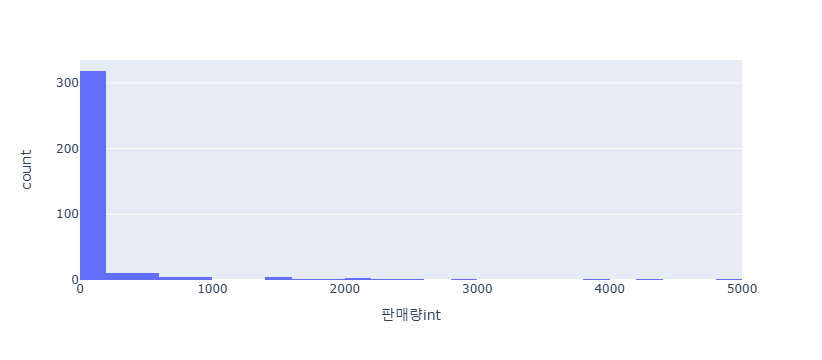

In [54]:
px.histogram(t1, x='판매량int')

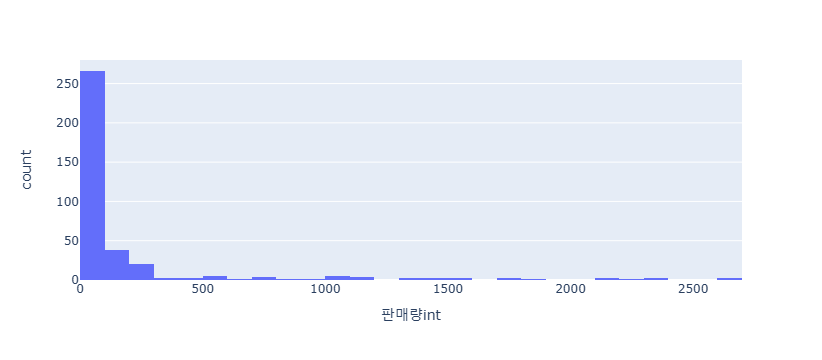

In [55]:
px.histogram(t2, x='판매량int')

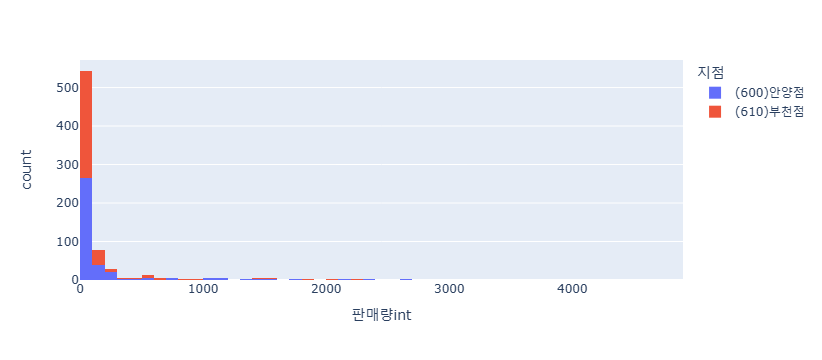

In [56]:
px.histogram(concat1.loc[cond1 | cond2],x='판매량int',color='지점')

## 6. '기간'별 가장 '판매량'의 '합'이 높은 '지점'을 확인하고, 
특정 '기간' (월)을 입력했을 때, 해당 월의 '지점' 별 '판매량'의 합을 

result_{월}.xlsx로 저장하는 함수를 생성하시오.

In [58]:
p1 = concat1.pivot_table( index= '지점', values='판매량int', columns='기간',
                        aggfunc='sum')
p1

# 정렬이 안되어있다.

기간,06월,07월,08월
지점,,,
(1154)의정부점,6829.0,8149.0,11856.0
(1155)별내점,8374.0,9143.0,10688.0
(1156)풍산점,12626.0,13270.0,13406.0
(1157)김포한강점,11767.0,13710.0,11825.0
(1158)세종점,10912.0,12844.0,11715.0
...,...,...,...
(L38)율전점,1782.0,2037.0,1936.0
(L39)본오점,3129.0,2929.0,2654.0
(L40)검암점,1712.0,2423.0,1959.0


In [61]:
p1['06월']

지점
(1154)의정부점      6829.0
(1155)별내점       8374.0
(1156)풍산점      12626.0
(1157)김포한강점    11767.0
(1158)세종점      10912.0
                ...   
(L38)율전점        1782.0
(L39)본오점        3129.0
(L40)검암점        1712.0
(L44)신길점        3189.0
(L46)용호점        2347.0
Name: 06월, Length: 656, dtype: float64

In [64]:
for i in concat1['기간'].unique():
    print(p1[i].sort_values(ascending=False).head(1).index[0])

(610)부천점
(610)부천점
(740)속초점


In [69]:
print(concat1['기간'].unique())
month_input = input('기간을 입력하시오')


cond1 = (concat1['기간'] == month_input)
month_t = concat1.loc[cond1]

p1=month_t.pivot_table( index = '지점',values='판매량int',aggfunc='sum')
p1.sort_values(by='판매량int',ascending=False)

['06월' '07월' '08월']


기간을 입력하시오 06월


,판매량int
지점,
(610)부천점,20594
(600)안양점,19655
(930)죽전점,19288
(840)월계점,19154
(966)성남점,18181
...,...
(4168)NBR문경중앙시장점,45
(1676)NB의정부민락2점,45
(4111)NBR인천심곡점,35


In [70]:
def func6():
    p1 = concat1.pivot_table( index= '지점', values='판매량int', columns='기간',
                        aggfunc='sum')
    for i in concat1['기간'].unique():
        print(p1[i].sort_values(ascending=False).head(1).index[0])
        print(concat1['기간'].unique())
        month_input = input('기간을 입력하시오')
        
        
        cond1 = (concat1['기간'] == month_input)
        month_t = concat1.loc[cond1]
        
        p1=month_t.pivot_table( index = '지점',values='판매량int',aggfunc='sum')
        p2 = p1.sort_values(by='판매량int',ascending=False)
        p2.to_excel(f'result_{month_input}.xlsx')
        return p2

func6()

(610)부천점
['06월' '07월' '08월']


기간을 입력하시오 06월


,판매량int
지점,
(610)부천점,20594
(600)안양점,19655
(930)죽전점,19288
(840)월계점,19154
(966)성남점,18181
...,...
(4168)NBR문경중앙시장점,45
(1676)NB의정부민락2점,45
(4111)NBR인천심곡점,35


## 7. '상품명'에 '마스크'와'휴지' 제품을 나누어 분석하고자 한다. 상품명을 '휴지'와 '마스크'로 분류한 뒤, (나머지는 '기타') '상품분류'라는 파생변수를 만들어, 두 상품의 '판매량'의 대표값의 차이를 가설 검정 하시오.
- 가설 수립 및 결론도 작성하셔야 합니다.

In [71]:
concat1.head()

,순번,상품코드,상품명,합계,지점,판매량,기간,판매량int
0,1.0,1801828.0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),65402,(1154)의정부점,174,06월,174
1,2.0,1801859.0,블루방역황사마스크 65매 KF94,1,(1154)의정부점,0,06월,0
2,3.0,40786179.0,클린위즈 매직클리너 얼룩제거 세트,2158,(1154)의정부점,4,06월,4
3,4.0,41001356.0,트루마리 순수휴지 30미터 90롤,3649,(1154)의정부점,14,06월,14
4,5.0,88005324.0,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),1,(1154)의정부점,0,06월,0


In [72]:
def func7(x):
    if '마스크' in x:
        return '마스크'
    elif '휴지' in x: 
        return '휴지'
    else :
        return '기타'
concat1['상품분류'] = concat1['상품명'].apply(func7)
concat1[['상품명','상품분류']]

,상품명,상품분류
0,자연숨결 식약처 허가 초미세먼지 마스크 대형 60매(KF94),마스크
1,블루방역황사마스크 65매 KF94,마스크
2,클린위즈 매직클리너 얼룩제거 세트,기타
3,트루마리 순수휴지 30미터 90롤,휴지
4,자연숨결 식약처 허가 초미세먼지 마스크 대형30매 + 중형 30매(KF94),마스크
...,...,...
236993,[쨍하고해뜰집]제습제풀세트(다용도제습제30통+지시겔1봉),기타
236994,[리얼뽀송이]제습제세트,기타
236995,[미라클워터]다목적세정제17종괴물용량풀세트,기타
236996,[쨍하고해뜰집]지시겔1봉(20개),기타


In [73]:
# 두 상품의 '판매량'의 대표값의 차이를 가설 검정 하시오.
cond1 = (concat1['상품분류']=='마스크')
cond2 = (concat1['상품분류']=='휴지')

t1 = concat1.loc[cond1]
t2 = concat1.loc[cond2]

In [74]:
# 정규성 검정 (정규성을 띠는가)
stats.normaltest(t1['판매량int'])

NormaltestResult(statistic=31820.563309226873, pvalue=0.0)

In [75]:
stats.normaltest(t2['판매량int'])

NormaltestResult(statistic=30664.231154107765, pvalue=0.0)

In [77]:
# 마스크와 휴지는 유의미하게 다르게 팔리는가?
stats.ranksums(t1['판매량int'],t2['판매량int'])
# 마스크와 휴지는 유의미하게 다르게 팔린다.

RanksumsResult(statistic=14.193416467479825, pvalue=1.0063403187290814e-45)

In [78]:
t1['판매량int'].mean() # 마스크 27개 팔림

27.580235932965078

In [79]:
t2['판매량int'].mean() # 휴지 29개 팔림

29.70667540492463

In [80]:
# 결론 마스크와 휴지는 통계적으로 유의미하게 다른 판매량을 기록한다.
# 이유 : pvalue < 0.05 이기 때문에 대립가설 채택 -> 즉 유의미하게 다른 판매량을 기록한다.

# 다변수 검정
- 정규분포를 따르는 연속형 자료의 집단 간 비교

In [81]:
df1 = pd.read_csv('08_Data.csv')
df1

,Unnamed: 0,Code_Num,Datetime,Process_Type,ST,Tube Furnace CP,Tube Furnace1 OP,Tube Furnace1 Temp,Tube Furnace2 OP,Tube Furnace2 Temp,Tube Furnace3 OP,Tube Furnace3 Temp,Tube Furnace4 OP,Tube Furnace4 Temp,Z1-OP1,Z1-OP2,Z1-Temp
0,0,GroupA,2022-01-03 11:22,OP-A,NaN,0.450497,73.527404,NaN,59.989422,868.759544,52.249481,NaN,72.134908,NaN,74.255730,76.879748,NaN
1,1,GroupA,2022-01-03 11:22,OP-A,NaN,0.457370,79.149174,878.116929,62.027232,883.821264,50.617109,890.740760,71.245235,894.430606,66.323571,71.297720,NaN
2,2,GroupA,2022-01-03 11:22,OP-A,68.724636,0.454914,78.946336,866.441979,62.235532,882.850031,52.218350,864.373065,72.705558,893.530501,72.909936,71.579322,99.614201
3,3,GroupA,2022-01-03 11:22,OP-A,69.161116,0.456540,78.445719,876.350472,61.608260,906.208463,52.863552,891.107865,73.975640,896.347636,68.754355,73.537496,99.376221
4,4,GroupA,2022-01-03 11:22,OP-C,69.181098,0.460100,76.673808,903.587677,61.589311,867.215131,52.297196,893.206883,71.887865,871.594283,69.692302,72.461153,99.809053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93038,93038,GroupF,2022-01-07 6:17,OP-C,71.033373,0.452082,100.134826,872.637943,46.360373,903.099390,49.074962,907.047411,69.737301,885.226007,79.388710,75.183327,100.349989
93039,93039,GroupF,2022-01-07 6:17,OP-C,70.279919,0.454568,100.495863,859.093360,47.415839,879.563033,48.813327,868.128755,68.664392,907.965662,74.321059,75.029649,100.779761
93040,93040,GroupF,2022-01-07 6:17,OP-C,70.743509,0.449965,100.043239,877.629751,46.868824,878.300413,49.373930,871.801850,69.552292,883.993894,71.790816,76.608828,100.050607
93041,93041,GroupF,2022-01-07 6:17,OP-C,70.135205,0.454477,100.663784,903.544591,46.148800,900.809104,48.564558,880.085060,68.732966,889.400098,65.348224,72.388889,100.295380


In [82]:
df1.columns

Index(['Unnamed: 0', 'Code_Num', 'Datetime', 'Process_Type', 'ST',
       'Tube Furnace CP', 'Tube Furnace1 OP', 'Tube Furnace1 Temp',
       'Tube Furnace2 OP', 'Tube Furnace2 Temp', 'Tube Furnace3 OP',
       'Tube Furnace3 Temp', 'Tube Furnace4 OP', 'Tube Furnace4 Temp',
       'Z1-OP1', 'Z1-OP2', 'Z1-Temp'],
      dtype='object')

## 정규분포를 따르는 두 집단의 평균 비교

In [83]:
# 각 Code_Num (공정배치그룹) 별 Z1~OP1 (공정온도 출력량) 평균의 차이가 있는가?
df1['Code_Num'].value_counts()

Code_Num
GroupD    31729
GroupC    26982
GroupB    13299
GroupF     7473
GroupA     7342
GroupE     6218
Name: count, dtype: int64

In [85]:
df1['Code_Num'].value_counts().head(2).index[1]

'GroupC'

In [86]:
cond1 = (df1['Code_Num'] == df1['Code_Num'].value_counts().head(1).index[0])
cond2 = (df1['Code_Num'] == df1['Code_Num'].value_counts().head(2).index[1])


In [88]:
t1 = df1.loc[cond1] # Grooup D
t2 = df1.loc[cond2] # Group C

In [90]:
stats.normaltest(t1['Z1-OP1']) # 정규분포를 따름 , pvalue > 0.05 , 귀무가설

NormaltestResult(statistic=0.45941327604808013, pvalue=0.7947667226435516)

In [92]:
stats.normaltest(t2['Z1-OP1']) # 정규분포를 따름 pvalue > 0.05 , 귀무가설 , pvalue = 23 %

NormaltestResult(statistic=2.8668515001589796, pvalue=0.23849051231867696)

In [94]:
# 두 집단 모두 정규분포를 따름으로 , 등분산 검정을 수행

stats.bartlett(t1['Z1-OP1'],t2['Z1-OP1'])
# 귀무가설 : 두 집단의 분산은 같다고 볼 수 있다.
# 대립가설 : 두 집단의 분산은 다르다고 볼 수 있다.

BartlettResult(statistic=0.15980353542672476, pvalue=0.6893374613172697)

In [96]:
# 결론 : 귀무가설,  pvalue가 68% 이므로 귀무가설을 채택한다.
# 따라서 t test를 수행 

In [98]:
stats.ttest_ind(t1['Z1-OP1'],t2['Z1-OP1'],equal_var=True)

# 등분산인 경우 : equal_vsar = True / 그렇지 않은 경우 False

TtestResult(statistic=-0.08592110963765062, pvalue=0.9315294234984884, df=58709.0)

In [99]:
# 귀무가설을 채택한다. : 따라서 Group D / Group C 의 
# 건조온도출력량에는 통계적으로 유의미한 차이가 없다.

In [100]:
# Code_Num : A / E / F
cond1 = df1['Code_Num'] == 'GroupA'
cond2 = df1['Code_Num'] == 'GroupE'
cond3 = df1['Code_Num'] == 'GroupF'

t1 = df1.loc[cond1] #A
t2 = df1.loc[cond2] # E
t3 = df1.loc[cond3] # F

In [101]:
# Z1-OP1
# 각 그룹의 정규성 확인
print( stats.normaltest(t1['Z1-OP1']))
print( stats.normaltest(t2['Z1-OP1']))
print( stats.normaltest(t3['Z1-OP1']))

NormaltestResult(statistic=3.671411795679153, pvalue=0.1595008706997435)
NormaltestResult(statistic=3.1395858023119314, pvalue=0.20808827273562336)
NormaltestResult(statistic=0.37943212967748347, pvalue=0.8271939700559496)


In [102]:
# 결과 : 세 그룹 모두 정규분포를 따름

In [103]:
# 등분산성을 확인
stats.bartlett( t1['Z1-OP1'],t2['Z1-OP1'],t3['Z1-OP1'])

BartlettResult(statistic=0.18947012176777617, pvalue=0.9096138948482111)

In [104]:
# 귀무가설 : 집단 간 분산이 같다
# 결론 : A / E / F 그룹의 Z1-OP1의 분산은 통계적으로 같다고 할 수 있다.
# 3집단 이상 정규 분포를 따르면 : ANOBA test를 한다

In [105]:
# 세 집단이 통계적으로 유의미하게 다른가?
stats.f_oneway(t1['Z1-OP1'],t2['Z1-OP1'],t3['Z1-OP1'],)

F_onewayResult(statistic=2.034783349896693, pvalue=0.13073453040417232)

In [106]:
# 결론
# A / E / F 그룹의 건조온도출력량에는 차이가 없다.

In [107]:
# X Y 의 상관성을 확인
# X : 연속형 / Y : 연속형 인 경우에 상관성을 확인합니다.
# 두 개의 공정건조온도 출력량은 서로 상관성이 있는가?

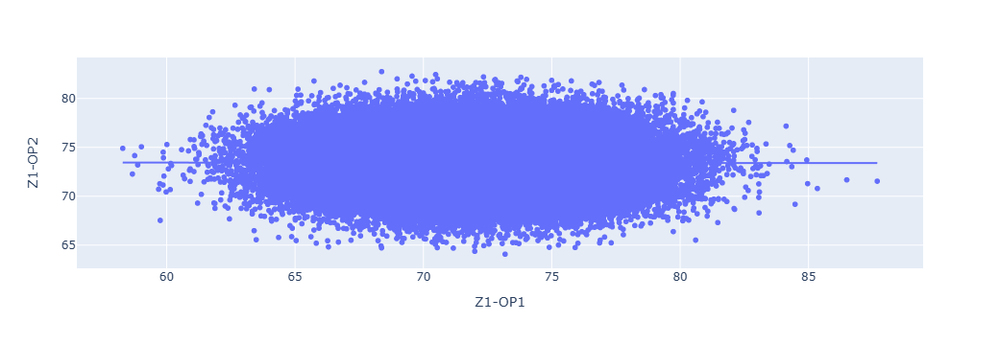

In [108]:
px.scatter(df1, x='Z1-OP1',y='Z1-OP2',trendline='ols')

In [109]:
# 시각적으로 봤을땐 , 상관성이 있다고 보여지지 않는다.

In [110]:
# 가설검정
stats.normaltest(df1['Z1-OP1'])

NormaltestResult(statistic=2.18765496291767, pvalue=0.3349320908928943)

In [111]:
stats.normaltest(df1['Z1-OP2'])

NormaltestResult(statistic=1.1121501227551858, pvalue=0.573455429905634)

In [112]:
# 두 집단 모두 정규분포를 따름

In [113]:
# 두 집단 모두 정규분포를 따르는 경우의 상관성
# pearsonr test 수행

stats.pearsonr(df1['Z1-OP1'],df1['Z1-OP2'])

PearsonRResult(statistic=-0.00242340319097993, pvalue=0.4597851757502812)

In [114]:
# 귀무가설 : 상관성이 없다.
# 대립가설 : 상관성이 있다.

# statistic=-0.00242 : 기울기
# 결론 : 상관성이 없다.

In [115]:
# 상관성 확인2

In [117]:
# Tube Furnace CP : 가스 침탄량
# ST : 세정기 온도 값

stats.normaltest(df1['Tube Furnace CP'])
# 정구 분포를 따르지 않음

NormaltestResult(statistic=46072.55461165357, pvalue=0.0)

In [119]:
stats.normaltest(df1['ST'])
# 결측값이 있다.

NormaltestResult(statistic=nan, pvalue=nan)

In [120]:
df1_clean = df1.dropna()

In [121]:
# 결측값 제거 후 가설검정
stats.normaltest(df1_clean['Tube Furnace CP'])

NormaltestResult(statistic=45980.21679557492, pvalue=0.0)

In [122]:
stats.normaltest(df1_clean['ST'])

NormaltestResult(statistic=3427.6390518307962, pvalue=0.0)

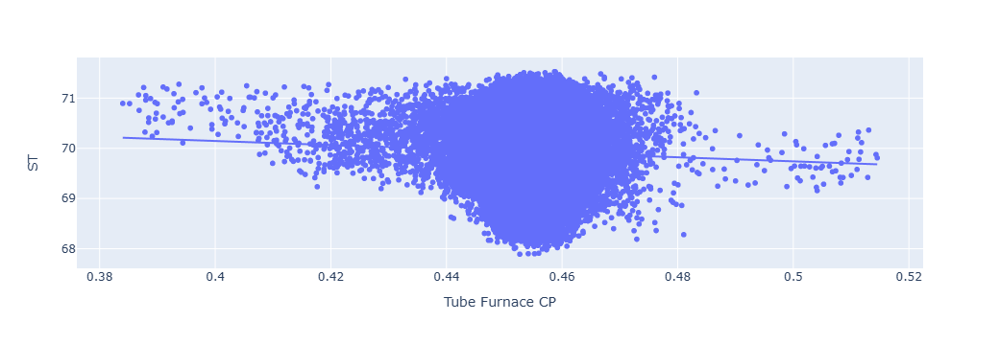

In [125]:
px.scatter(df1_clean,x='Tube Furnace CP',y='ST',trendline='ols')

In [126]:
# 시각적으로 봤을땐 상관성이 있어보인다. 왜? 기울기가 있어서

In [127]:
# 두 집단이 정규분포를 따르지 않는 경우의 상관성
# spearmanr

stats.spearmanr(df1_clean['Tube Furnace CP'],df1_clean['ST'])

SignificanceResult(statistic=-0.0083096008162668, pvalue=0.011341012934082387)

In [129]:
# 실제로 통계적으로 상관성이 있다. , pvalue < 0.05 , 대립가설 
# 두 연속형 자료는 상관성이 있음